# Exploratory data Analysis "Article Text Classification"

#### In part 2 I found there were 20 categories available. For the purposes of this project the focus will be on:

### Major Categories defined by business :
1. Home Loans
2. Personal Loans
3. Car Loans
4. Credit Cards
5. Superannuation
6. Savings Accounts
7. Terms Deposits
8. Bank Account

In [1]:
# Load all necessary packages and libraries
import pandas as pd
import numpy as np
import seaborn as sns 

import matplotlib.pyplot as plt

plt.style.use('bmh')
%matplotlib inline

In [2]:
## Loading dataset
df=pd.read_csv('clean_data.csv',index_col=[0])

In [3]:
#Renaming the columns
df.rename(columns={
    "article_vertical":"category_type",
    "title":"article_title",
    "body":"article",
    "pubDate":"publish_date",
    "readingTime":"reading_time"},inplace=True)

In [4]:
df.head()

,category_type,article_title,article,publish_date,reading_time
0,credit-cards,Working from home? ATO says to make your tax w...,We’re a little over a month away from the end ...,"Thu, 13 Sep 2018 03:50:02 +0000",3
1,home-loans,Westpac and St.George offer home loan incentives,Australians looking for new home loans or cons...,"Wed, 27 Jun 2018 01:52:39 +0000",2
2,home-loans,Suburbs with the greatest property change reve...,CoreLogic research has revealed the Australian...,"Tue, 26 Jun 2018 06:23:12 +0000",5
3,default,RateCity Sales,"RateCity users are often savvy shoppers, who u...","Fri, 10 Mar 2017 01:36:53 +0000",4
4,home-loans,"Line of credit home loans, explained and analy...",Do you want more financial freedom? Have you g...,"Wed, 08 Mar 2017 14:00:18 +0000",4


In [5]:
#Listing out the different categories
df.category_type.unique()

array(['credit-cards', 'home-loans', 'default', 'superannuation',
       'car-loans', 'savings-accounts', 'bank-accounts', 'personal-loans',
       'investment-funds', 'term-deposits', 'media', 'car-insurance',
       'online-trading', 'health-insurance',
       'income-protection-insurance', 'life-insurance', 'margin-loans',
       'foreign-exchange', 'infographic', 'infographics'], dtype=object)

In [6]:
#Number of articles before filtering the 8 categories
df.shape

(3618, 5)

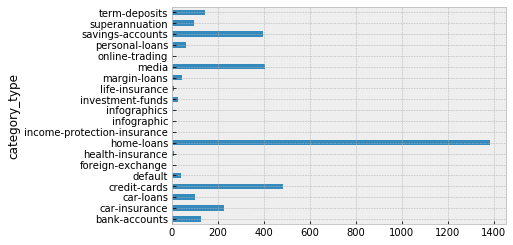

In [7]:
df.groupby('category_type')[['article']].count().plot(kind='barh',legend=False)

## Filtering dataset based on 8 major categories (defined by business)

In [8]:
focussed_category=['credit-cards','home-loans','superannuation','car-loans',
                   'savings-accounts','bank-accounts','personal-loans','term-deposits']

In [9]:
df_cat=df[df.category_type.isin(focussed_category)]

In [10]:
#Number of articles after filtering
df_cat.shape

(2814, 5)

In [11]:
#Check for null values
df_cat.isnull().sum()

category_type    0
article_title    1
article          7
publish_date     0
reading_time     0
dtype: int64

In [12]:
#Checking what the nulls are
null_articles=df_cat[df_cat.article.isnull()]

In [13]:
null_article_title=df_cat[df_cat.article_title.isnull()]

In [14]:
#From the looks of it the nulls are not articles, looks like a promo of sorts. Will drop it anyways.
null_article_title

,category_type,article_title,article,publish_date,reading_time
3590,home-loans,NaN,MEDIA RELEASERateCity welcomes Justice Hayne’s...,"Fri, 28 Sep 2018 06:41:51 +0000",1


## Dropping all the null values

In [15]:
df_cat=df_cat.dropna()

In [16]:
#Number of articles after removing the null rows
df_cat.shape

(2806, 5)

Plotting the article distribution

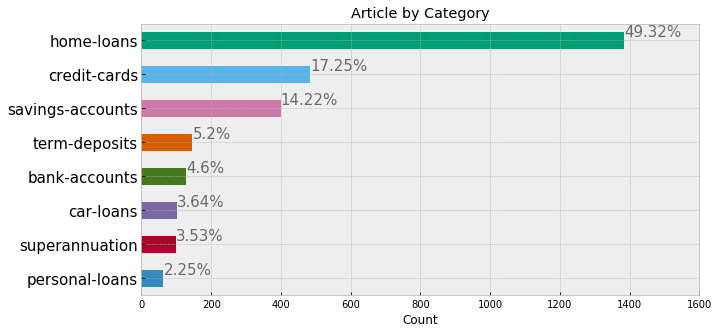

In [17]:
ax=df_cat.category_type.value_counts(ascending=True).plot(kind='barh',figsize=(10,5),title='Article by Category')
plt.yticks(size=15)
plt.xlabel('Count')
ax.set_xticks([0, 200, 400, 600, 800, 1000, 1200, 1400, 1600])
# find the values and append to list
totals=[]
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)

# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()+.3, i.get_y()+.38, \
            str(round((i.get_width()/total)*100, 2))+'%', fontsize=15,
color='dimgrey')

50% of the articles belong to home loans.There's a class imbalance an issue that I may have to address during the model building

### Plot based on reading time for each article

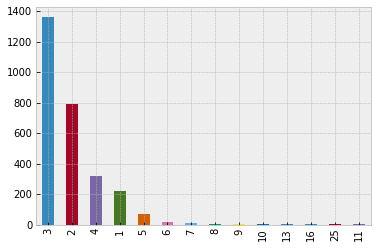

In [18]:
df_cat.reading_time.value_counts().plot(kind='bar')

## Article by publish date

In [19]:
#Pulling out category and publish dates
df_date=df_cat[['category_type','publish_date','reading_time']]

In [21]:
#Coverting the publish date into a datetime object
df_date['publish_date']=pd.to_datetime(df_date['publish_date']).copy()

C:\Users\Suraj Satheesan\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [22]:
df_date.dtypes

category_type            object
publish_date     datetime64[ns]
reading_time              int64
dtype: object

In [23]:
#Column for the day of the week
df_date['day']=df_date.publish_date.dt.day_name()

C:\Users\Suraj Satheesan\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [24]:
#Column for the year
df_date['year']=df_date.publish_date.dt.year

In [25]:
#Column for the month
df_date['month']=df_date.publish_date.dt.month_name()

In [26]:
#Column for the date in the month
df_date['date']=df_date.publish_date.dt.day

In [27]:
df_date.head()

,category_type,publish_date,reading_time,day,year,month,date
0,credit-cards,2018-09-13 03:50:02,3,Thursday,2018,September,13
1,home-loans,2018-06-27 01:52:39,2,Wednesday,2018,June,27
2,home-loans,2018-06-26 06:23:12,5,Tuesday,2018,June,26
4,home-loans,2017-03-08 14:00:18,4,Wednesday,2017,March,8
5,credit-cards,2017-03-08 02:35:11,4,Wednesday,2017,March,8


### Plot based on day of the week published

In [28]:
byday=df_date.day.value_counts()
weekdays = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
mapping = {day: i for i, day in enumerate(weekdays)}
key = byday.index.map(mapping)    
byday = byday.iloc[key.argsort()]

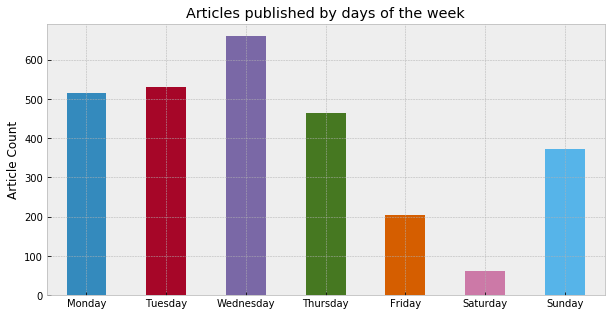

In [29]:
ax=byday.plot(kind='bar',legend=False,title='Articles published by days of the week',figsize=(10,5))
ax.set_xticklabels(labels=weekdays,rotation='horizontal')
plt.ylabel('Article Count');

### Plot based on month published

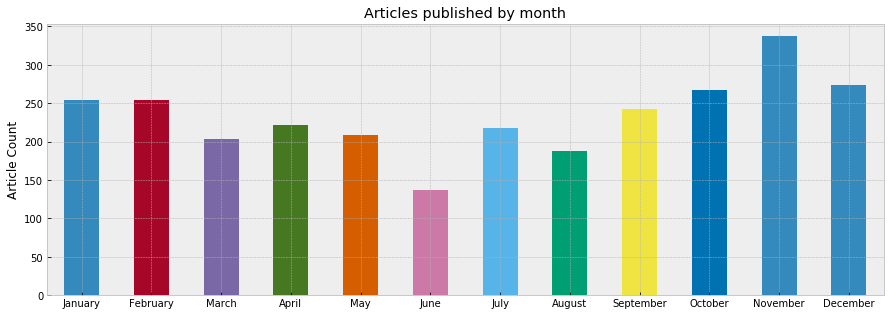

In [30]:
bymonth=df_date.month.value_counts()
months = ['January', 'February','March','April','May','June', 
          'July','August','September','October','November','December']
mapping = {month: i for i,month in enumerate(months)}
key = bymonth.index.map(mapping)    
bymonth = bymonth.iloc[key.argsort()]
ax=bymonth.plot(kind='bar',legend=False,title='Articles published by month',figsize=(15,5))
ax.set_xticklabels(labels=months,rotation='horizontal')
plt.ylabel('Article Count');

### Plot based on year published

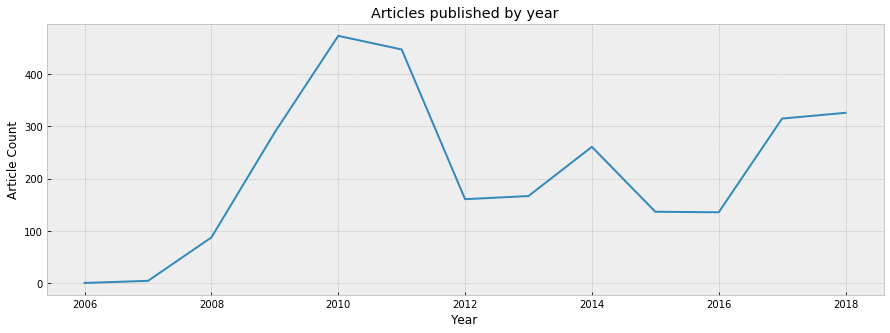

In [31]:
df_date.year.value_counts().sort_index().plot(kind='line',title='Articles published by year',figsize=(15,5),grid=True)
ax.set_xticklabels(labels=list(df_date.year.unique()),rotation='horizontal')
plt.ylabel('Article Count')
plt.xlabel('Year')
plt.style.use('default');

### Other addtional plots 

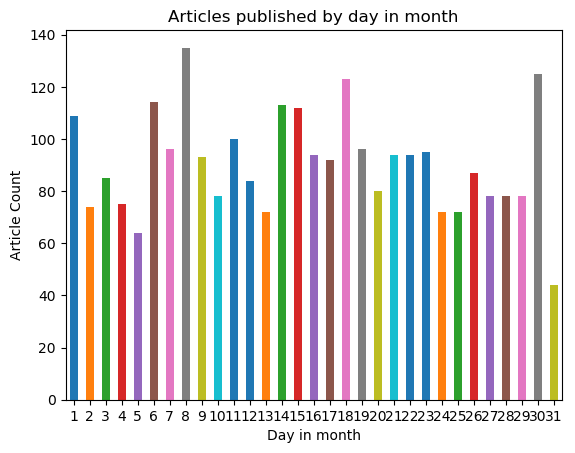

In [32]:
#Number of articles published based on the day of the month
df_date
df_date.date.value_counts().sort_index().plot(kind='bar',title='Articles published by day in month')
plt.xlabel('Day in month')
plt.xticks(rotation='horizontal')
plt.ylabel('Article Count');

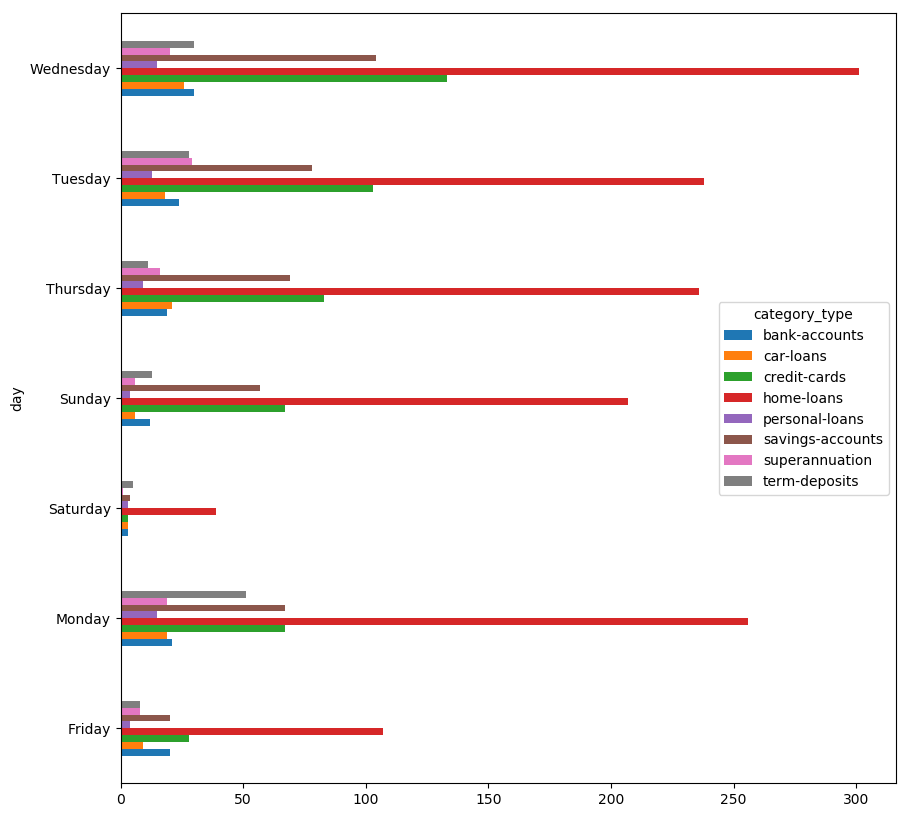

In [33]:
# df_date.groupby('day')[['category_type']].counts().unstack(0).plot(kind='barh')

df_date.groupby('category_type').day.value_counts().unstack(0).plot(kind='barh',figsize=(10,10))

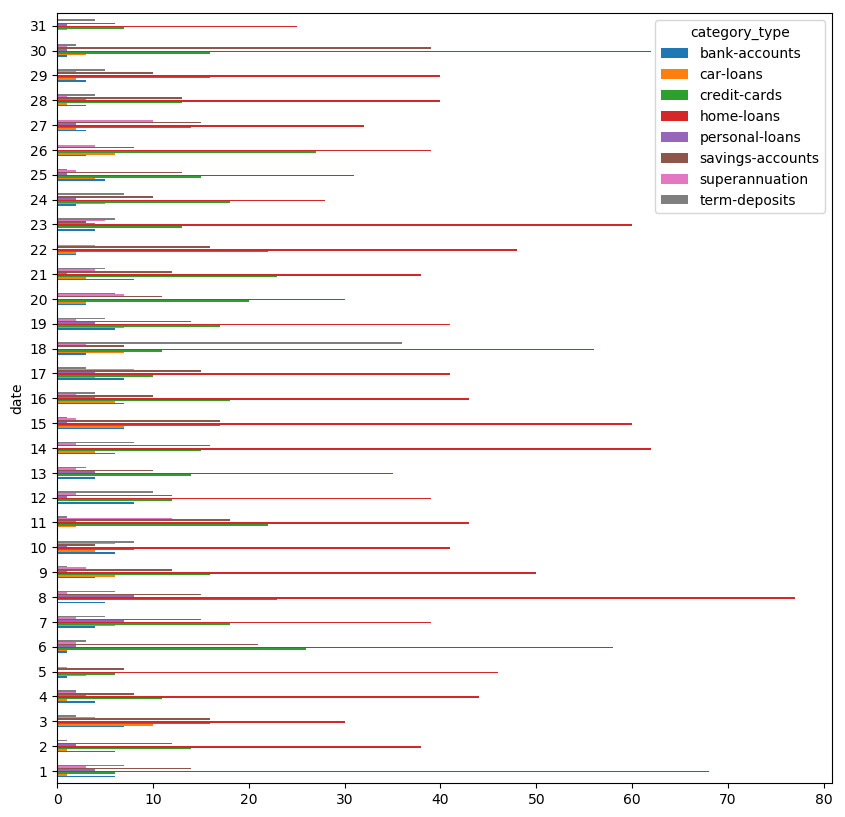

In [34]:
df_date.groupby('category_type').date.value_counts().unstack(0).plot(kind='barh',figsize=(10,10))

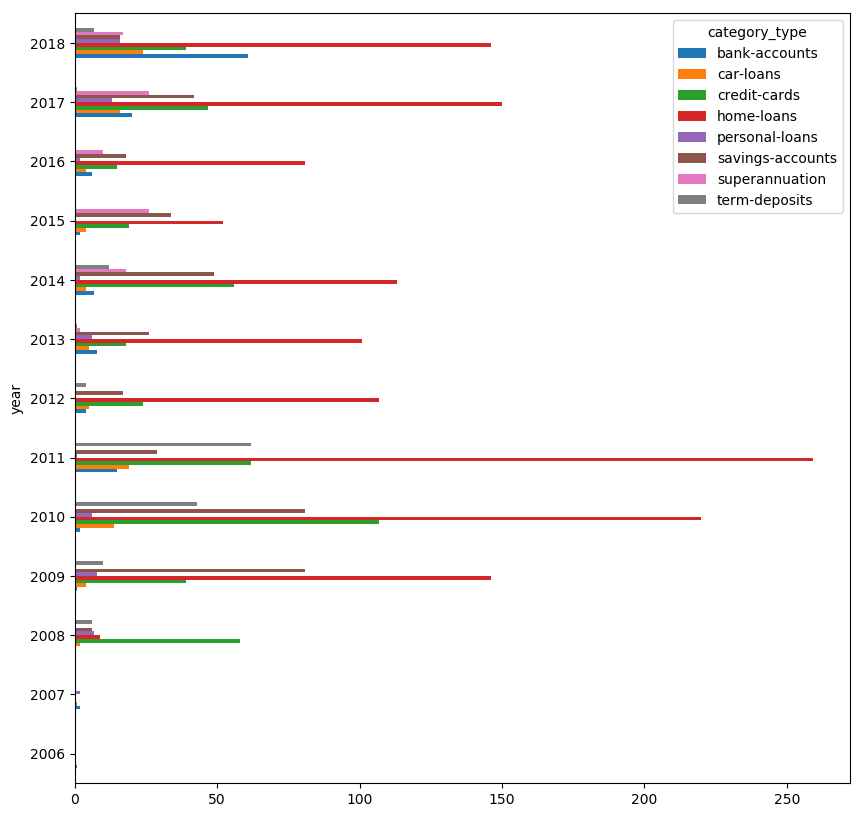

In [34]:
df_date.groupby('category_type').year.value_counts().unstack(0).plot(kind='barh',figsize=(10,10))

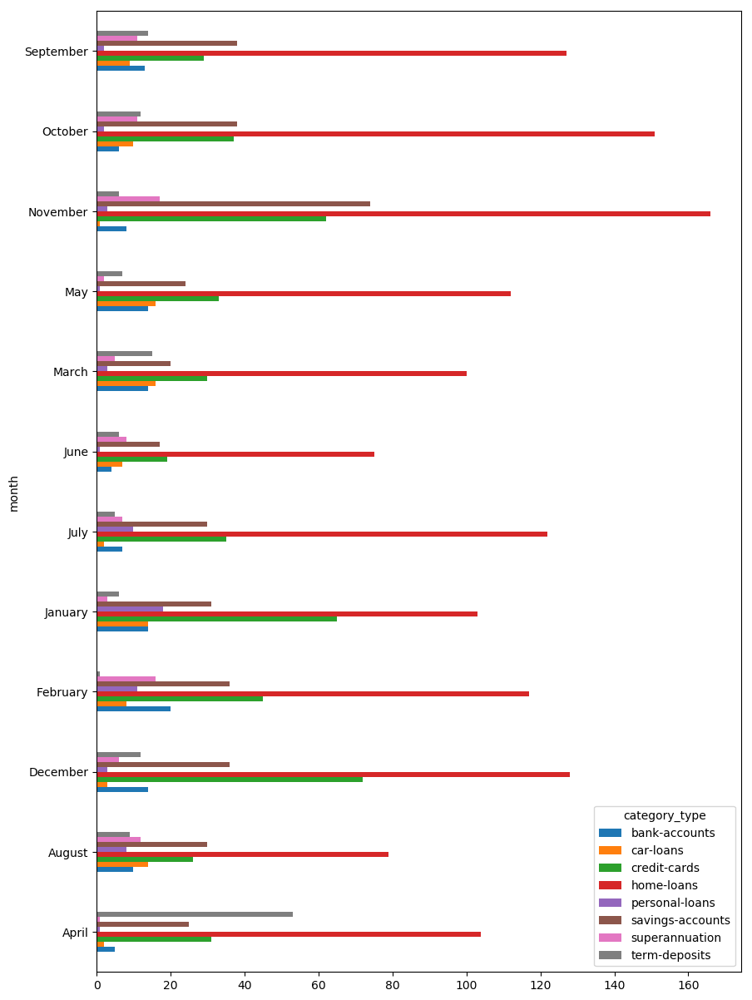

In [35]:
df_date.groupby('category_type').month.value_counts().unstack(0).plot(kind='barh',figsize=(10,15))

### Articles published by category in each year

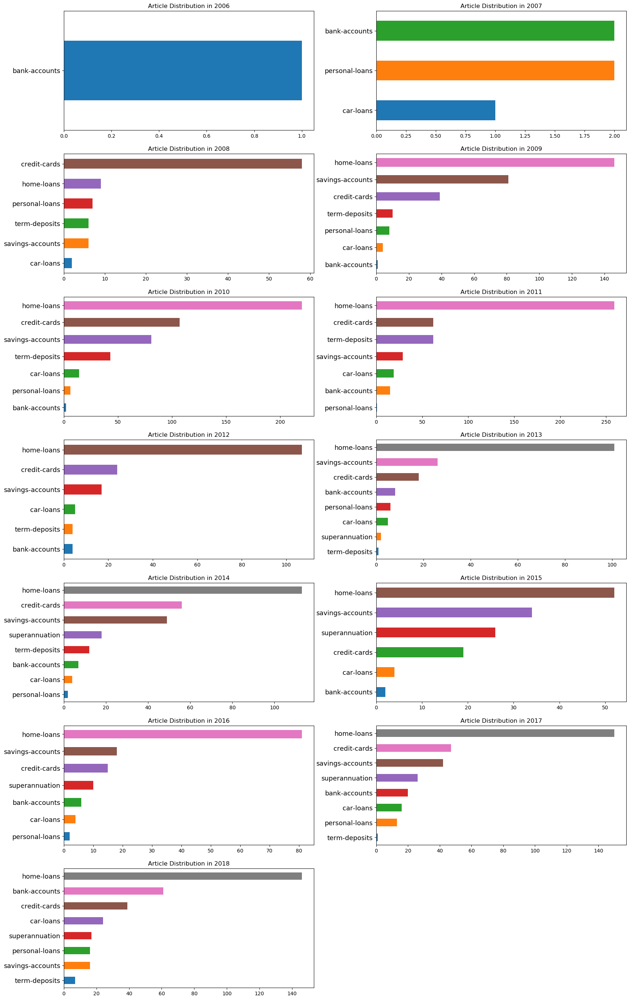

In [36]:
years=[2006, 2007, 2008, 2009, 2010, 2011,2012,2013,2014,2015,2016,2017,2018]
for c,num in zip(years, range(1,14)):
    art_date0=df_date[df_date['year']==c]
    plt.subplot(9,2,num)
#     figsize=(10,8),title='Article Distribution among the category ');
    ax=art_date0.category_type.value_counts(ascending=True).plot(kind='barh',figsize=(20,25))
    plt.yticks(size=13)
    plt.subplots_adjust(wspace=0.25, top=1.5)
    ax.set_title('Article Distribution in {}'.format(c))

## Article word and sentence counts

In [18]:
#Column for word count in each article
df_cat['word_count'] = df_cat['article'].apply(lambda x: len(str(x).split(" ")))

In [19]:
df_cat.head()

,category_type,article_title,article,publish_date,reading_time,word_count
0,credit-cards,Working from home? ATO says to make your tax w...,We’re a little over a month away from the end ...,"Thu, 13 Sep 2018 03:50:02 +0000",3,434
1,home-loans,Westpac and St.George offer home loan incentives,Australians looking for new home loans or cons...,"Wed, 27 Jun 2018 01:52:39 +0000",2,240
2,home-loans,Suburbs with the greatest property change reve...,CoreLogic research has revealed the Australian...,"Tue, 26 Jun 2018 06:23:12 +0000",5,328
4,home-loans,"Line of credit home loans, explained and analy...",Do you want more financial freedom? Have you g...,"Wed, 08 Mar 2017 14:00:18 +0000",4,560
5,credit-cards,What your shopping addiction is doing to your ...,We’ve all felt that rush and sense of achievem...,"Wed, 08 Mar 2017 02:35:11 +0000",4,717


In [20]:
#Average word count for each category
df_cat.groupby('category_type')['word_count'].mean()

category_type
bank-accounts       412.906977
car-loans           400.696078
credit-cards        439.543388
home-loans          414.177023
personal-loans      426.142857
savings-accounts    444.238095
superannuation      437.919192
term-deposits       324.760274
Name: word_count, dtype: float64

In [21]:
# Overall average word count
df_cat.word_count.mean()

418.73235923022094

## Ngrams before stemming and lemming

Here I will carry out some text preprocessing on the articles such as lemmatization and stemmatization for the NLTK library,
create plot for word dominance in each category and check for distinction

In [39]:
art_cat=df_cat[['category_type','article_title']]

In [40]:
der={ k : art_cat.loc[df['category_type'] == k, 'article_title'].values for k in art_cat['category_type'].unique() }


In [41]:
#For the purpose of creating unigram, bigram and trigram plots I will define a function to call for each.
import sklearn.feature_extraction.text as text
def get_imp(bow,mf,ngram):
    tfidf=text.CountVectorizer(bow,ngram_range=(ngram,ngram),max_features=mf,stop_words='english')
    matrix=tfidf.fit_transform(bow)
    return pd.Series(np.array(matrix.sum(axis=0))[0],index=tfidf.get_feature_names()).sort_values(ascending=False).head(100)

In [42]:
#creating a dictionary for unigram count
imp_terms_unigram={}
for y in der:
    bow=der.get(y).tolist()
    imp_terms_unigram[y]=get_imp(bow,mf=100,ngram=1)

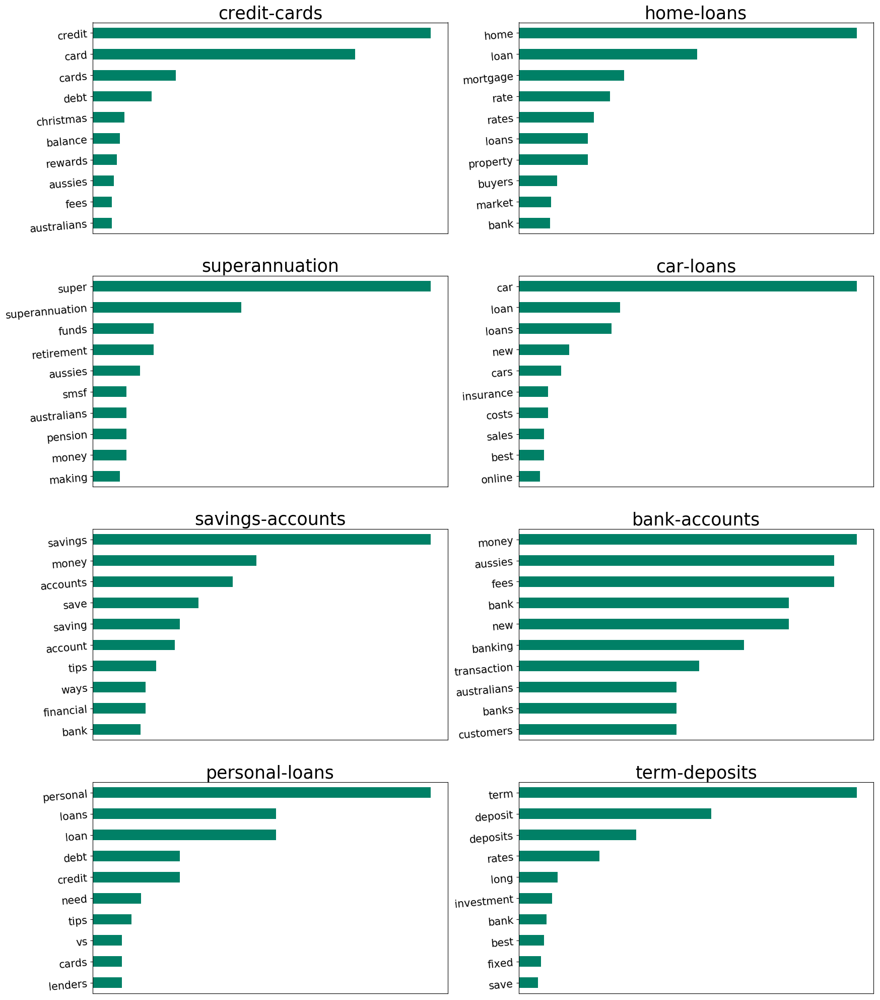

In [43]:
# Plotting the above dictionary for each category
i=0
for y in imp_terms_unigram:
    i=i+1
    plt.subplot(4,2,i)
    imp_terms_unigram.get(y).head(10).sort_values().plot(kind="barh",figsize=(20,25),colormap='summer')
    plt.title(y,fontsize=25)
    plt.xticks([])
    plt.yticks(size=15,rotation=5)

In [44]:
#creating a dictionary for bigram count
imp_terms_bigram={}
for y in der:
    bow=der.get(y).tolist()
    imp_terms_bigram[y]=get_imp(bow,mf=100,ngram=2)

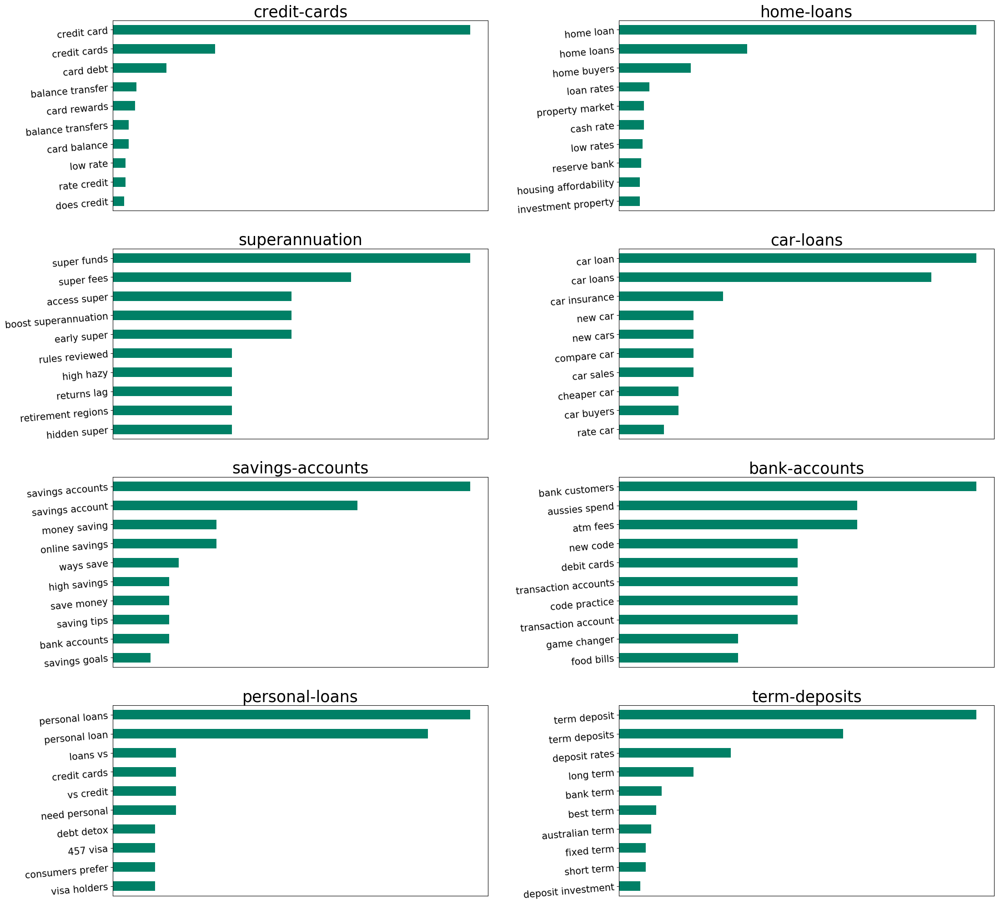

In [45]:
# Plotting the above dictionary for each category
i=0
for y in imp_terms_bigram:
    i=i+1
    plt.subplot(4,2,i)
    imp_terms_bigram.get(y).head(10).sort_values().plot(kind="barh",figsize=(25,25),colormap='summer')
    plt.title(y,fontsize=25)
    plt.xticks([])
    plt.yticks(size=15,rotation=5)
    plt.subplots_adjust(wspace=0.35)

From the plots there are alot fo repeats in the words for singular and plural, I will clean up the text to get rid of the repeats

## Visualizing the distinct groups using PCA

In [57]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
import string
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

In [49]:
category_id=df_cat.category_type.factorize()
category_id

(array([0, 1, 1, ..., 1, 7, 1], dtype=int64),
 Index(['credit-cards', 'home-loans', 'superannuation', 'car-loans',
        'savings-accounts', 'bank-accounts', 'personal-loans', 'term-deposits'],
       dtype='object'))

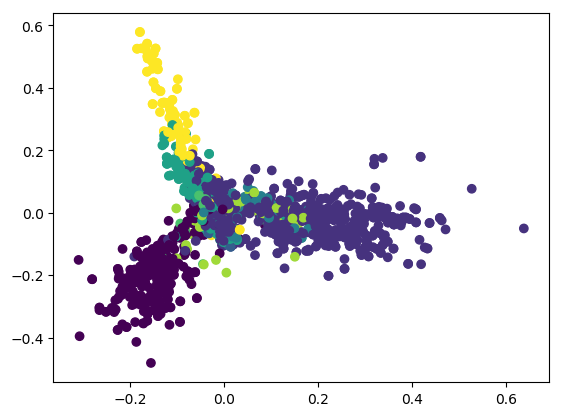

In [67]:
## Making a pipeline for CV and TfIdf
pipeline = Pipeline([
    ('vect', CountVectorizer()),
    ('tfidf', TfidfTransformer()),
])        

#Pulling out the title column to fit the pipeline on
X=pipeline.fit_transform(df_cat.article_title).todense()

#PCA will help to reduce the features from above to be able to make a 2D representation
pca = PCA(n_components=2).fit(X)
data2D = pca.transform(X)
plt.scatter(data2D[:,0], data2D[:,1], c=df_cat.category_type.factorize()[0])
plt.show()   

In [51]:
## This is not good group as its not possible to see 8 distinct groups
## Will need to do more cleaning, check for more common words or rare occurance of words and remove them

## Cleaning out punctuation,numbers to text,lowercase,remove stopwords

In [69]:
#Inflect library will help with numbers to text conversion
import inflect

#Importing the nltk library
from nltk.stem import LancasterStemmer, WordNetLemmatizer,PorterStemmer
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords

In [74]:
a=stopwords.words('english')


['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [88]:
#Function to clean out punctuation
def remove_punctuation(words):
    strip_words=words.translate(words.maketrans('', '', string.punctuation))
    return strip_words

#Function to make text lowercase
def lower_word(words):
    lower_words=words.lower()
    return lower_words

def lemmatize_word(words): 
    lemma=WordNetLemmatizer()
    words = word_tokenize(words)
    lemma_list=[]
    for w in words:
        lemma_list.append(lemma.lemmatize(w))
    return (" ".join(lemma_list))
        
def stem_word(words):
    stem=PorterStemmer()
    words = word_tokenize(words)
    stem_list=[]
    for w in words:
        stem_list.append(stem.stem(w))
    return (" ".join(stem_list))

def stem_and_lemma(words):
    new_article=lemmatize_word(words)
    new_article=stem_word(words)
    return new_article

In [89]:
df_cat['cleaned article']=df_cat.article.apply(lambda x: stem_and_lemma(x))

In [90]:
df_cat.head()

,category_type,article_title,article,publish_date,reading_time,word_count,cleaned article
0,credit-cards,Working from home? ATO says to make your tax w...,We’re a little over a month away from the end ...,"Thu, 13 Sep 2018 03:50:02 +0000",3,434,We ’ re a littl over a month away from the end...
1,home-loans,Westpac and St.George offer home loan incentives,Australians looking for new home loans or cons...,"Wed, 27 Jun 2018 01:52:39 +0000",2,240,australian look for new home loan or consid re...
2,home-loans,Suburbs with the greatest property change reve...,CoreLogic research has revealed the Australian...,"Tue, 26 Jun 2018 06:23:12 +0000",5,328,corelog research ha reveal the australian subu...
4,home-loans,"Line of credit home loans, explained and analy...",Do you want more financial freedom? Have you g...,"Wed, 08 Mar 2017 14:00:18 +0000",4,560,Do you want more financi freedom ? have you go...
5,credit-cards,What your shopping addiction is doing to your ...,We’ve all felt that rush and sense of achievem...,"Wed, 08 Mar 2017 02:35:11 +0000",4,717,We ’ ve all felt that rush and sens of achiev ...


## Ngrams after stemming,lemming and addtional preprocessing

In [91]:
art_cat2=df_cat[['category_type','cleaned article']]

In [93]:
der2={ k : art_cat2.loc[df['category_type'] == k, 'cleaned article'].values for k in art_cat2['category_type'].unique() }


In [95]:
import sklearn.feature_extraction.text as text
def get_imp(bow,mf,ngram):
    tfidf=text.CountVectorizer(bow,ngram_range=(ngram,ngram),max_features=mf,stop_words='english')
    matrix=tfidf.fit_transform(bow)
    return pd.Series(np.array(matrix.sum(axis=0))[0],index=tfidf.get_feature_names()).sort_values(ascending=False).head(100)

In [98]:
imp_terms_tfd={}
for y in der2:
    bow=der2.get(y).tolist()
    imp_terms_unigram[y]=get_imp(bow,mf=100,ngram=1)

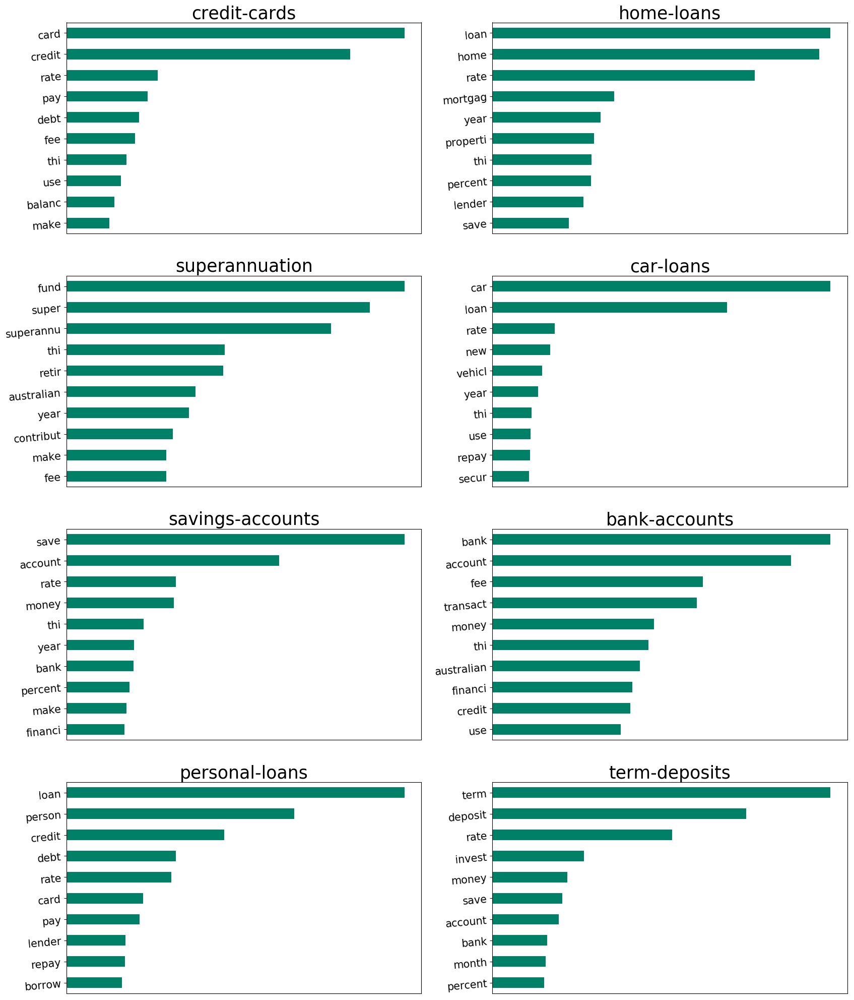

In [99]:
i=0
for y in imp_terms_unigram:
    i=i+1
    plt.subplot(4,2,i)
    imp_terms_unigram.get(y).head(10).sort_values().plot(kind="barh",figsize=(20,25),colormap='summer')
    plt.title(y,fontsize=25)
    plt.xticks([])
    plt.yticks(size=15,rotation=5)

In [100]:
imp_terms_bigram={}
for y in der2:
    bow=der2.get(y).tolist()
    imp_terms_bigram[y]=get_imp(bow,mf=100,ngram=2)

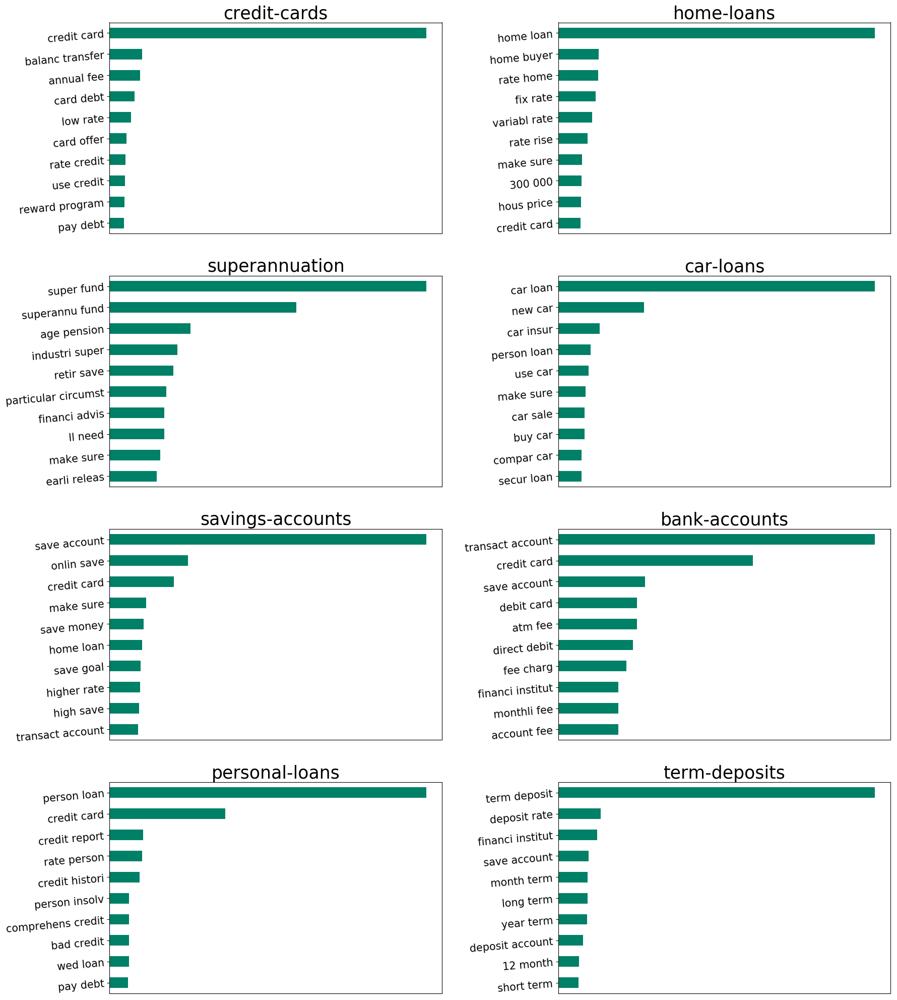

In [103]:
i=0
for y in imp_terms_bigram:
    i=i+1
    plt.subplot(4,2,i)
    imp_terms_bigram.get(y).head(10).sort_values().plot(kind="barh",figsize=(20,25),colormap='summer')
    plt.title(y,fontsize=25)
    plt.xticks([])
    plt.yticks(size=15,rotation=5)
    plt.subplots_adjust(wspace=0.35)

The repeats have gone down, I am happy with where I am at this point will move forward from here

## WORDCLOUD

In [108]:
from wordcloud import WordCloud, STOPWORDS


In [109]:
sw=stopwords.words('english')


In [110]:
cat_art = df_cat.groupby('category_type')['cleaned article'].apply(', '.join).reset_index()
cat_art=pd.DataFrame(cat_art)

0


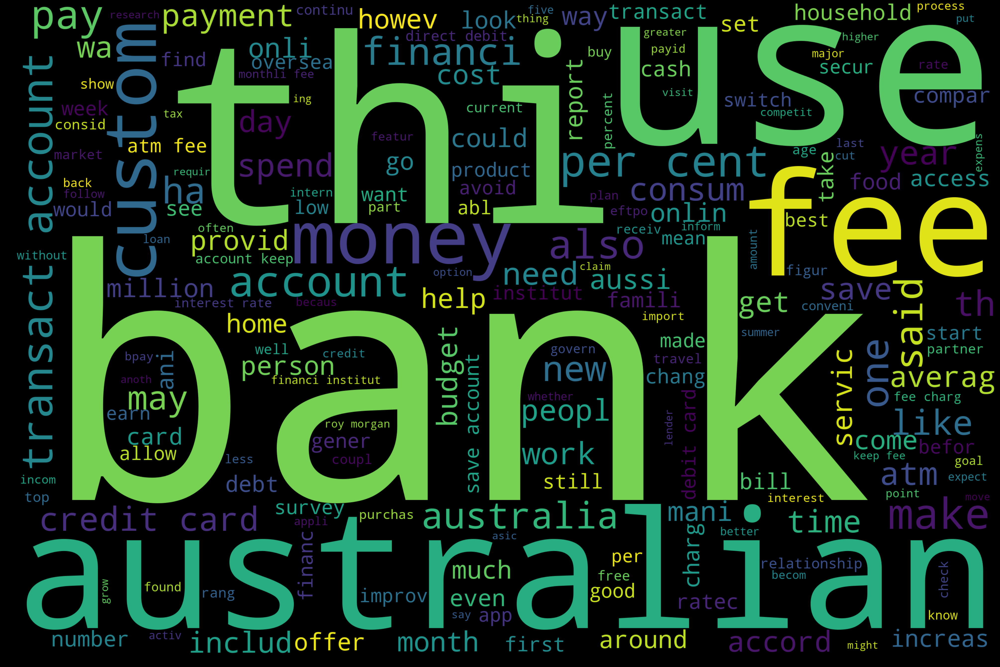

1


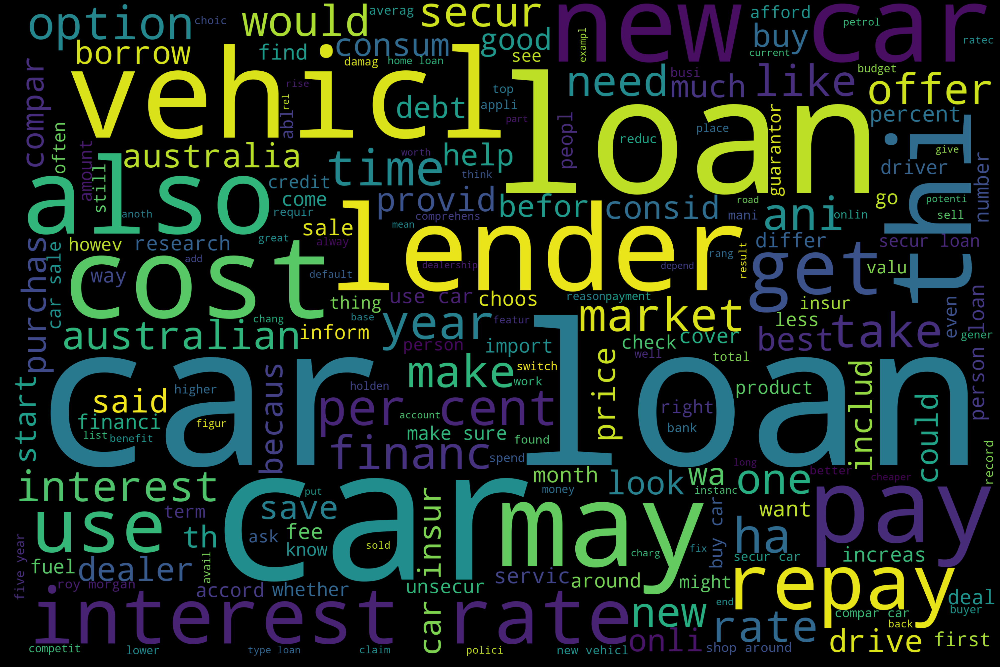

2


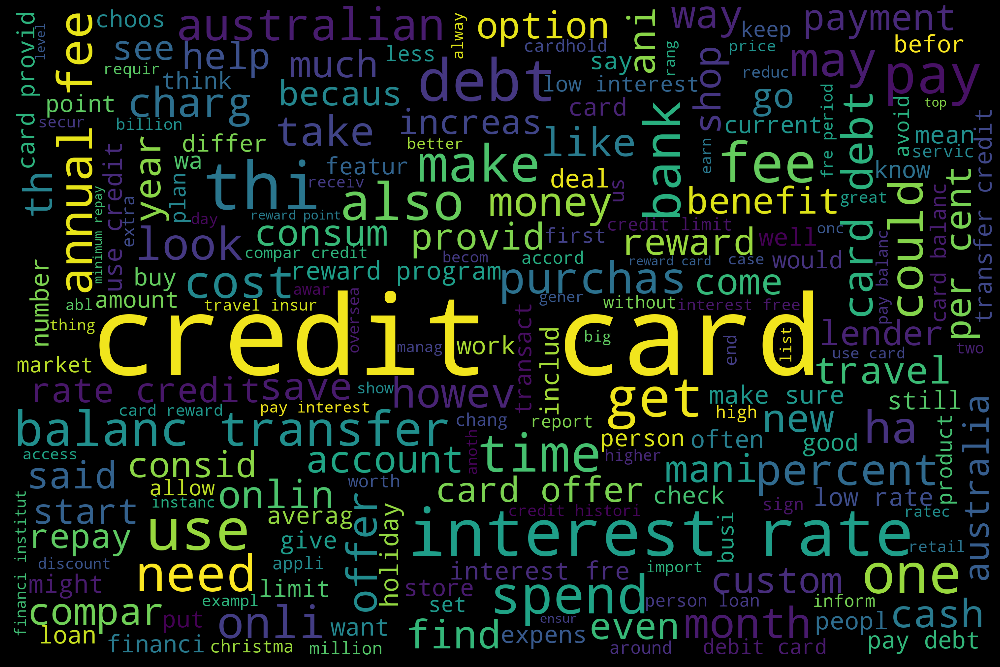

3


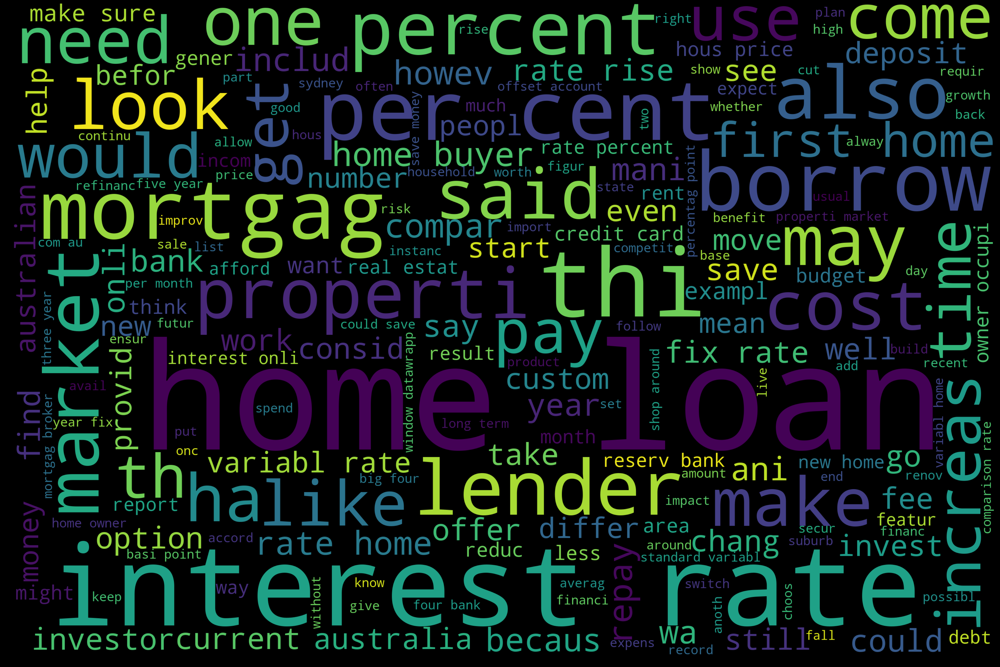

4


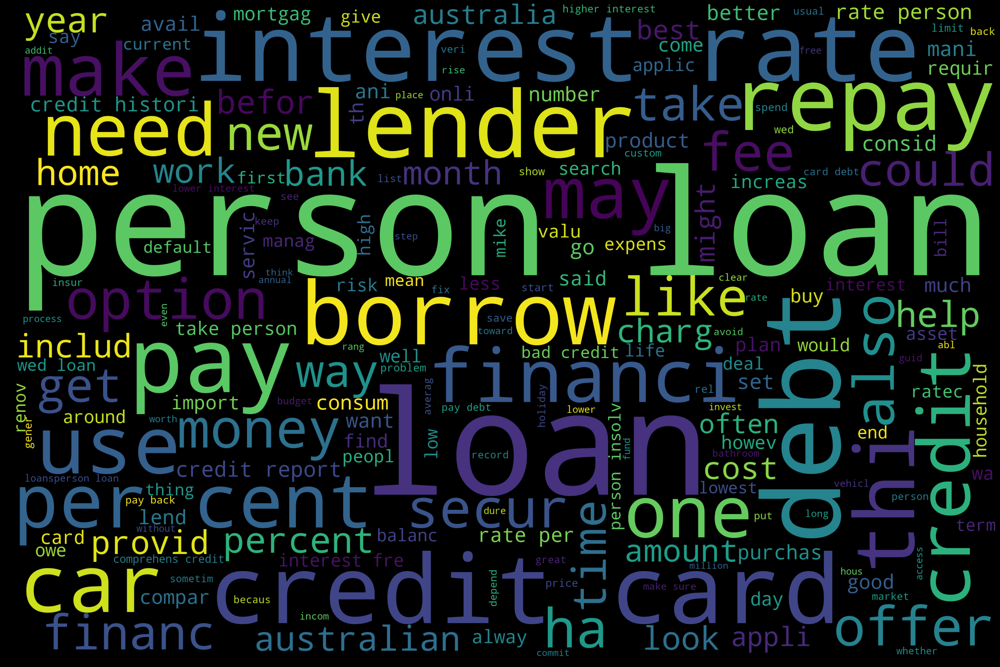

5


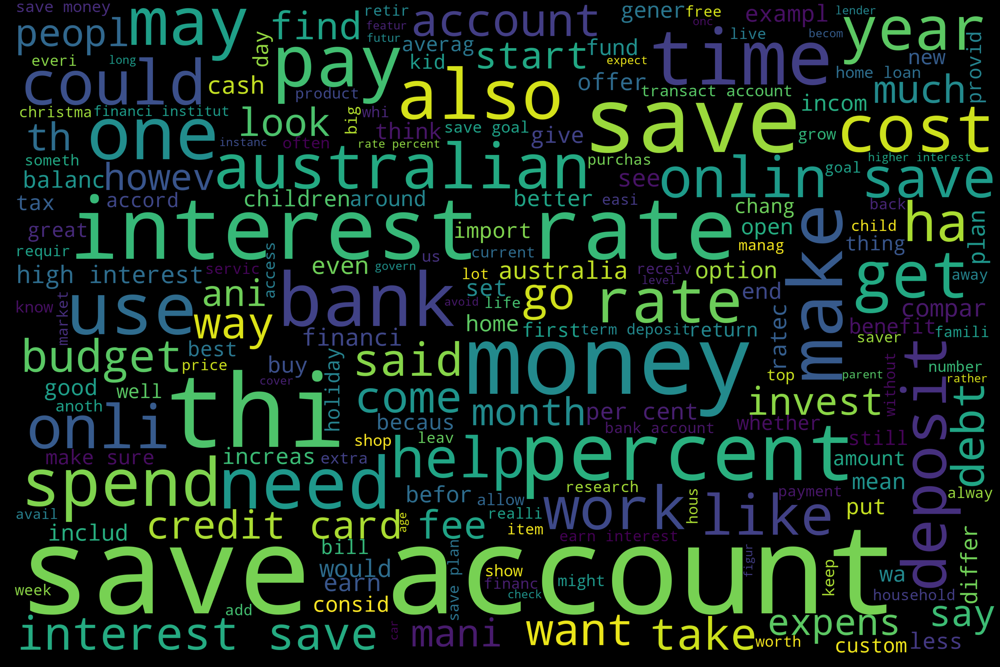

6


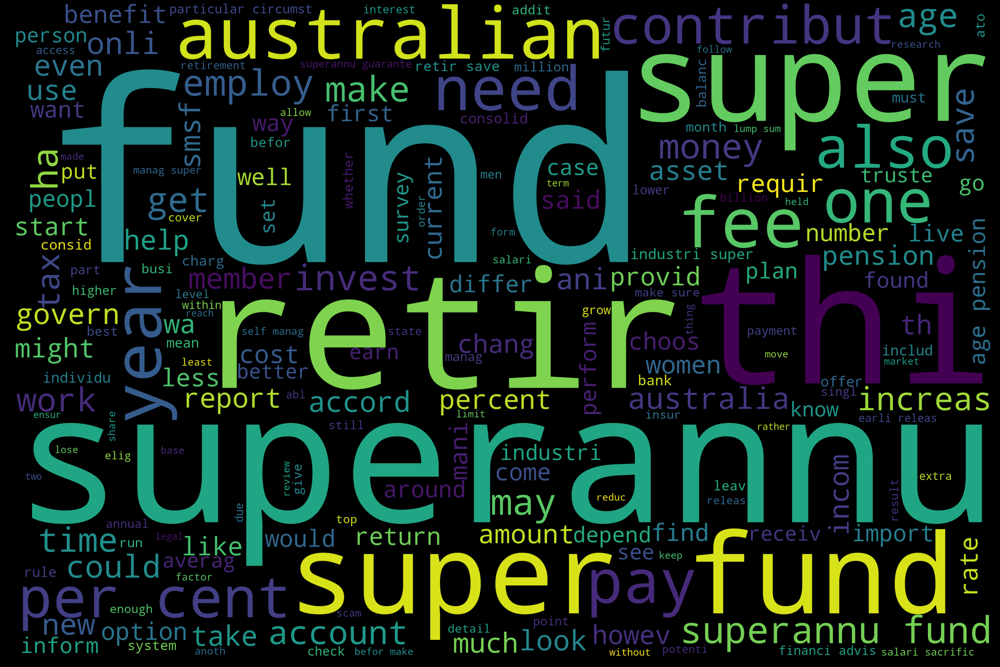

7


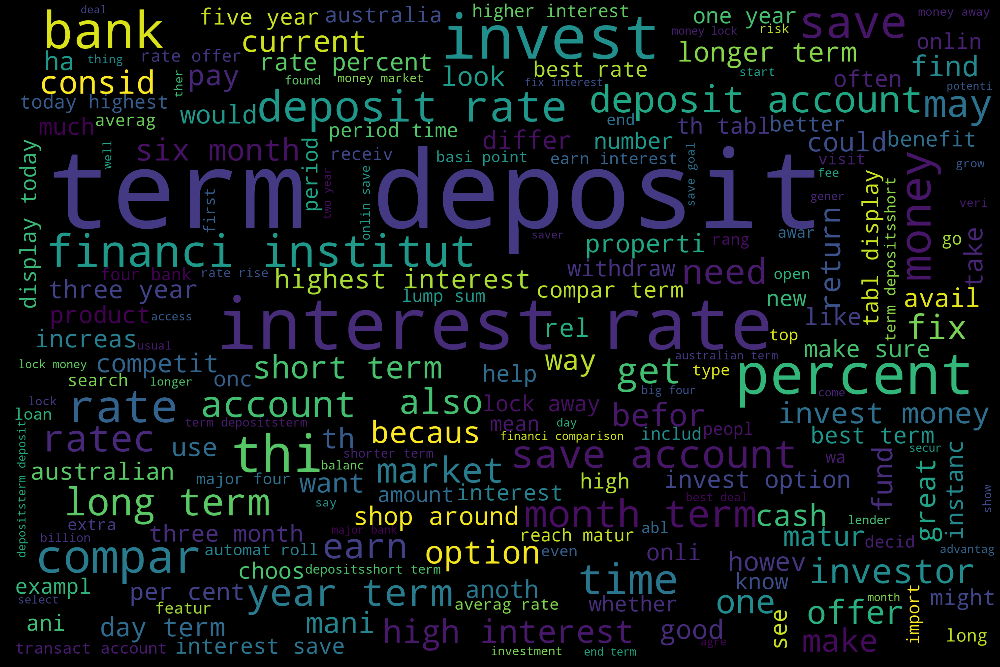

In [111]:
for i in cat_art.index:
    print(i)
    wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = sw).generate(str(cat_art.iloc[i,1]))
    name=cat_art.iloc[i,0]
    fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
    plt.imshow(wordcloud, interpolation = 'bilinear')
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.savefig('{}.png'.format(name))
    plt.show()
    



### I will move on now to part 3 to start the model building